***

# 5.0 Emotion Detection on CNN -  Report


## 5.1 Problem Statement


In 2019, Apple App Store's global ecosystem supported over USD519 Billion in Commerence. According to Apple's Newsroom, m-commerce apps generated the vast majority of sales, and of those, retail was the largest, at USD268 billion. These apps include digital stores, virtual marketplaces, travel apps, ride hailing apps, food delivery apps etc. A joint study by Google and Temasek Holdings in 2018 also estimated the SEA's ecommerce industry to grow to US$240 billion by 2025. Moreover, it also said that  90% of Southeast Asians connect to the internet mainly through their mobile devices and this population of 350M "mobile-first" users is expected to grow.

According to Statista, Singapore has over 4.65M smartphone users with Apple's share of mobile devices to be at 33.6% of the marketshare. This plays to the tune of .. 1.6M Apple smartphone users in Singapore alone and large market for profit for Apple's App Store. 

Reviews not only influences customer's decisions and trust, but can also impact profits for the busisness. 

While some companies choose to reward customers for reviews, some may need to find resolution for inaccurate reviews. And when reviews ultimately impact how much you sell, how fast you sell, whether you sell your product or services, it all ties back to cost or lost in profits for businesses.

Consumers stand to gain from reviews as well. It is not surprising to know that a high majority of the consumers in this new age turn to the internet for reviews before making their product or service purchases, be it an new item in your grocery list, a new place to visit, a new game to play, or a new movie to watch. In this age of information, the importance of online customer reviews become more important than ever. 

While all data points to heavy usage of Apps in the App Store, when browsing through the store, we see only a fraction of user reviews coupled with very skewed ratings. This shows users not leaving their reviews and misrepresentation of ratings due to many reasons. 

To improve the quality and quantiy of reviews in the App Store, I prospose the ideal of having the consumer take a real time picture and have a Multi-class Classifier detect emotions and translate it to a quantitative review rating. This new form of reviewing may encourage more users to rate the products in the App Store.  

This also has the future option to add on recommender system to recommend popular words to add to the review. If sucessful, the tool will accurately predict emotions of faces. 




***

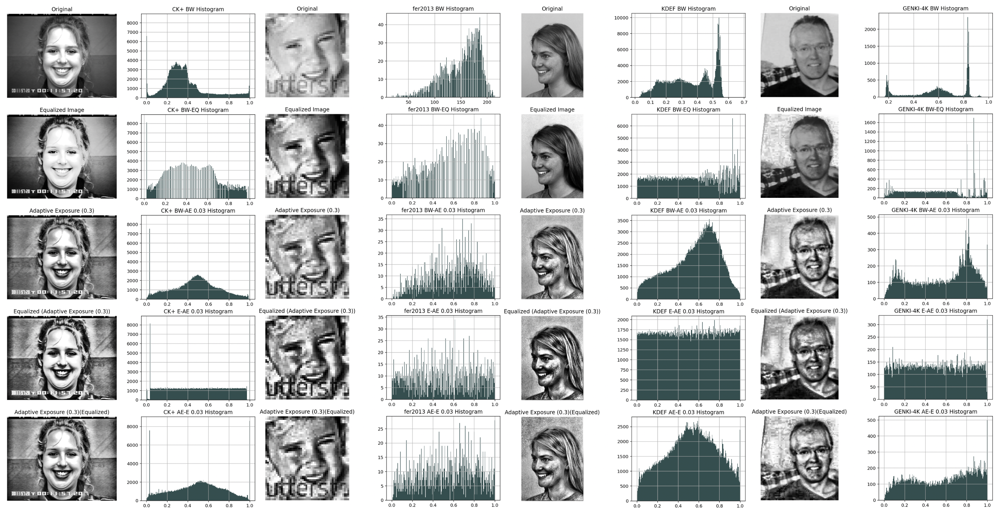## 4.2 Process



----
#### <u>Data</u>

For this task, I have gathered four datasets:

- <b>CK+</b>: The Extended Cohn-Kanade (CK+) database, 593 sequences across 123 subjects, labelled 8 emotions.
- <b>FER-2013</b>: The Facial Expression Recognition 2013 (FER-2013) Dataset, 32,298 images, labelled 7 emotions.
- <b>KDEF</b>: The Karolinska Directed Emotional Faces (KDEF), 4900 images across 70 subjects, labelled 7 emotions.
- <b>GENKI-4K</b>: The MPLab GENKI Database , 4000 images, labelled 2 emotions.


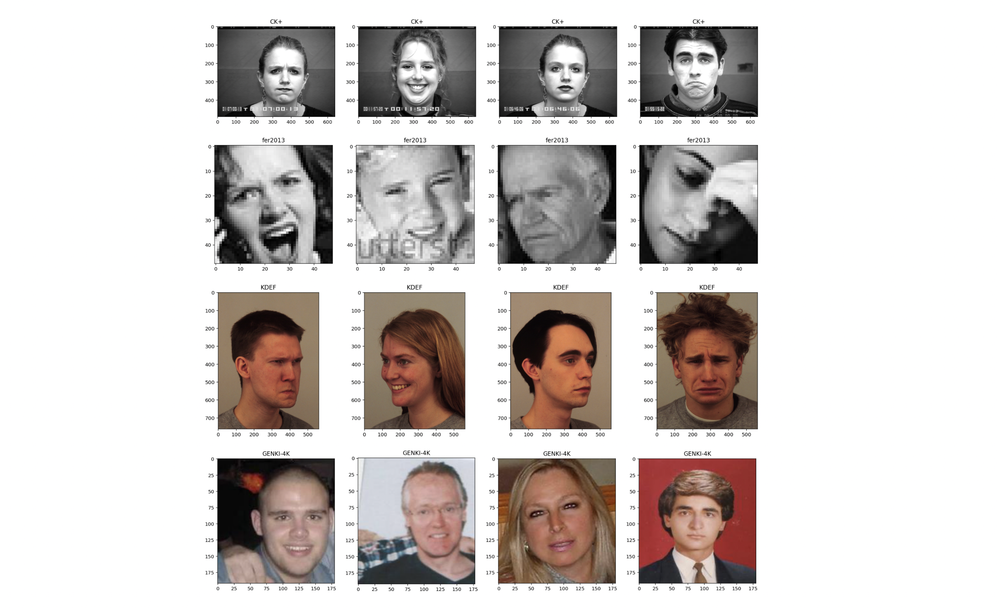


Since the datasets come in different sizes, channels and emotions. Some time was spent sorting them and getting them into a uniform format for input into the model:

1. pixel: 48 x 48
2. Greyscale (1 channel)
3. Emotions: Angry, Happy, Neutral, Sad

Some images awere dropped: 
1. Middle portions of Sequences in CK+ (extracted images 1-2 = Neutral, last 4 = emotion)
2. Full side profile pictures in KDEF
3. Emotions that were not to be used in this model



Results of Images that can be used in our dataset:
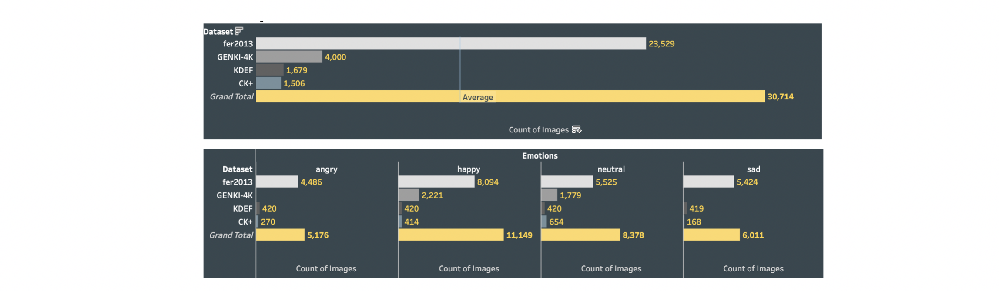

----

#### <u>Image Processing</u>

In this stage, images from CK+, KDEF and GENKI-4K were combined and put through a function to crop, greyscale and resize the images to match those of FER-2013. I then split the dataset into a train, validation and test set and multiplied the folders for the effects. 

I ended up with 5 sets of datasets:
1. Original
2. Adaptive Exposure (0.3)
3. Adaptive Exposure then Equalized
4. Equalized
5. Equalized then Adaptive Exposure

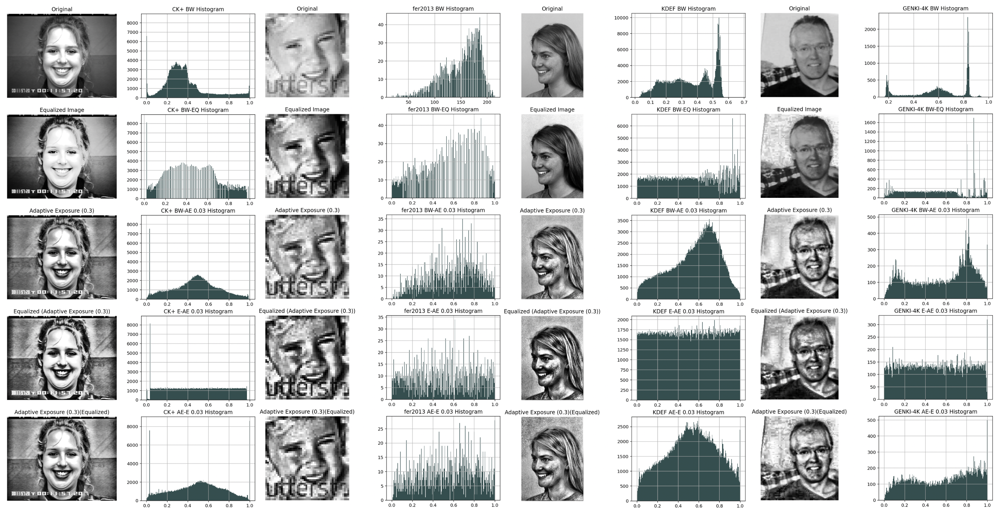


During the process, FER-2013 was curated FER-2013 as many of the images were either not in line with the emotion or corrupted/blank images causing a very low validation score. 


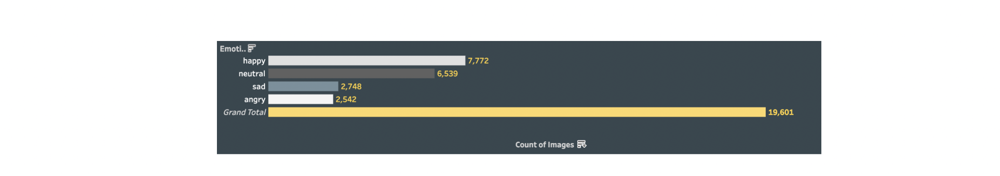


----
#### <u>Pixel Normalization and Augmentation</u>

Images will be normalized using an ImageGenerator which will rescale the pixel values from 0-255 to the range of 0-1. This makes convergence faster while training the network.

The train images will go throu augmentation which will aid CNN in feature learning. 

----

#### <u>Model </u>

I have choosen to work with Deep Learning, using a Convolutional neural network (ConvNets or CNNs) for this image recognition task. CNNs are widely use in image classification due to their ability for understanding abstract concepts in images. With no feature extraction needed on my part, the network is flexible to mold and built to suit the data I have in hand. 


----
#### <u>Model Metric</u>

#### Methods for dealing with unbalanced data:

There are several ways of dealing with imbalanced data in a multi-class classifier. 


For this task, I have chosen to use the weighted-average F1-score, or weighted-F1 to score my models. As mentioned earlier, F1 is a suitable metric for use in imbalanced multi-class datasets. This score will be further re-enforced by the use of the Precision and Recall scores and the Confusion Matrix to focus on a better scores for the two minority classes: Angry and Sad.

I have avoided using Accuracy for this imbalanced Dataset as it can be misleading, meaning that a high accuracy for the majority classes will skew the overall Accuracy results and encourage the model to focus on scoring on majority classes, leaving the minority classes with poor accuracy. 


----
#### <u>Baseline</u>

For my Baseline, I have created a simple CNN model to run on the Original Dataset. This yielded a weighted-F1 score of 0.47

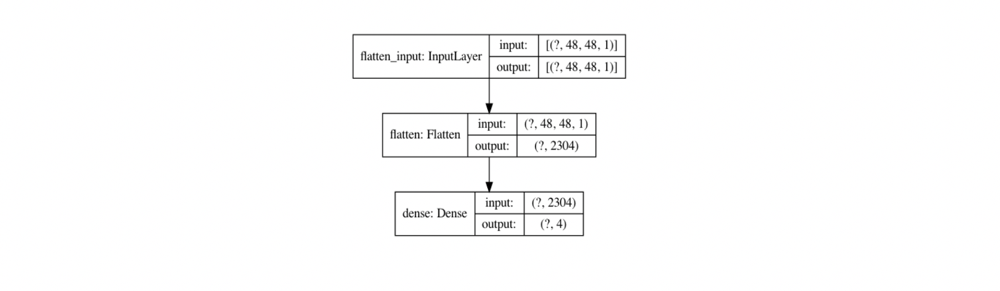


-----

#### <u>Building the Network</u>


This Network was built from scratch with inspiration from the Oxford Visual Geometry Group, or VGG CNN Model and was tested to have the highest accuracy and stability for this dataset. 

The process of elimination has been omitted from this notebook due to the size (100+ variations). Fortunately, the size of the data did not require for the fitting process to run for very long. Testing variations included and excluded the use of the following on many different layers:

- Batch Normalization
- Dropouts (various ratios)
- Maxpooling (various strides)
- Additional Convolution layers (various filters sizes)
- Different Batching combinations
- Different Learning rates
- Various Patience levels
- Elu activation
- Paddings
- Kernal Initializer (he_normal)
- Kernal Regularizer
- Activity Regularizer

This was the final built.
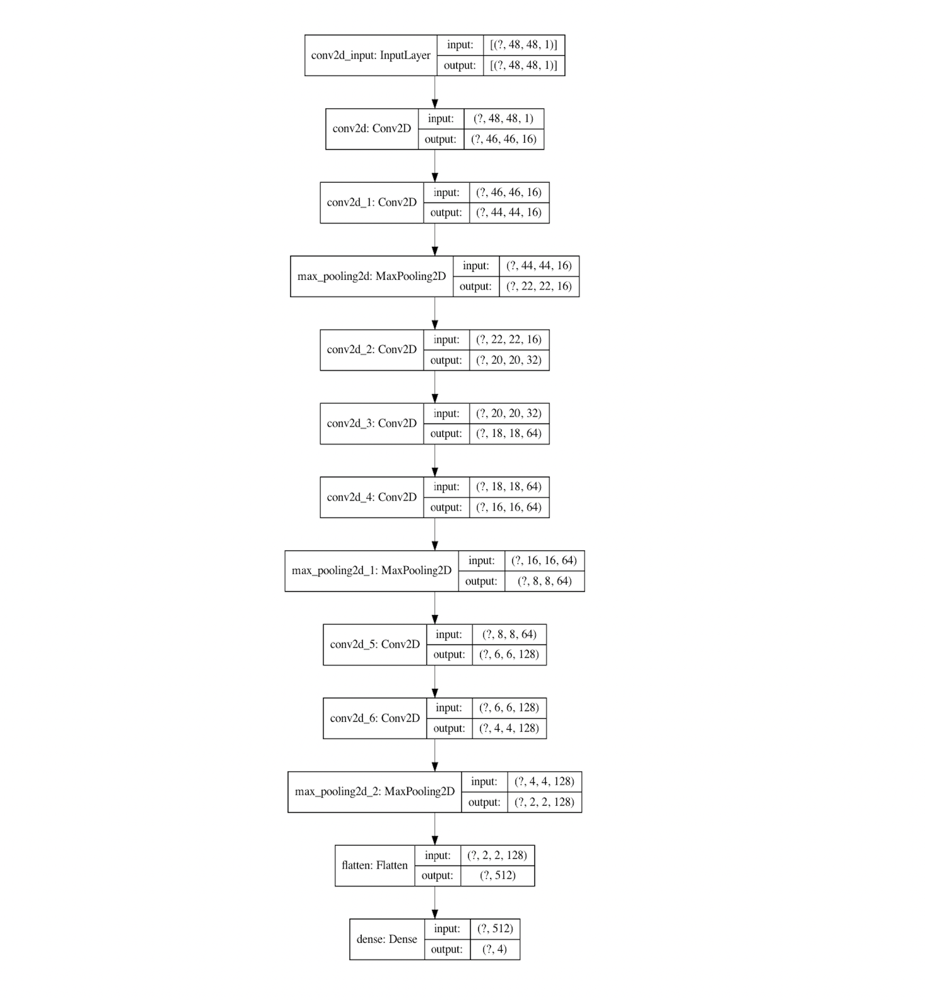

----

#### <u>Best Dataset</u>

In seperate notebooks, the 5 datasets were trained and validated, as well as a sixth baseline model trained on the original dataset. The AE Dataset and AEE Datatset both produced the same weighted-F1 score, with further analysis on the Confusion Matrix, Recall and Precision scores, I decided to use the AEE Dataset for the final run. 

The decision was made as AEE had better precision score despite AE having a more evenly distributed Precision and Recall score and having more correct predictions. The AEE dataset has lesser wrong guesses which means a reduction on typeII errors (False Positives) as backed by the Confusion Matrix on the minority classes.

E.g. AE model made 564 guesses of 'angry' with 384 being correct, but AEE made only 477 guesses in "angry" with 353 being correct. 

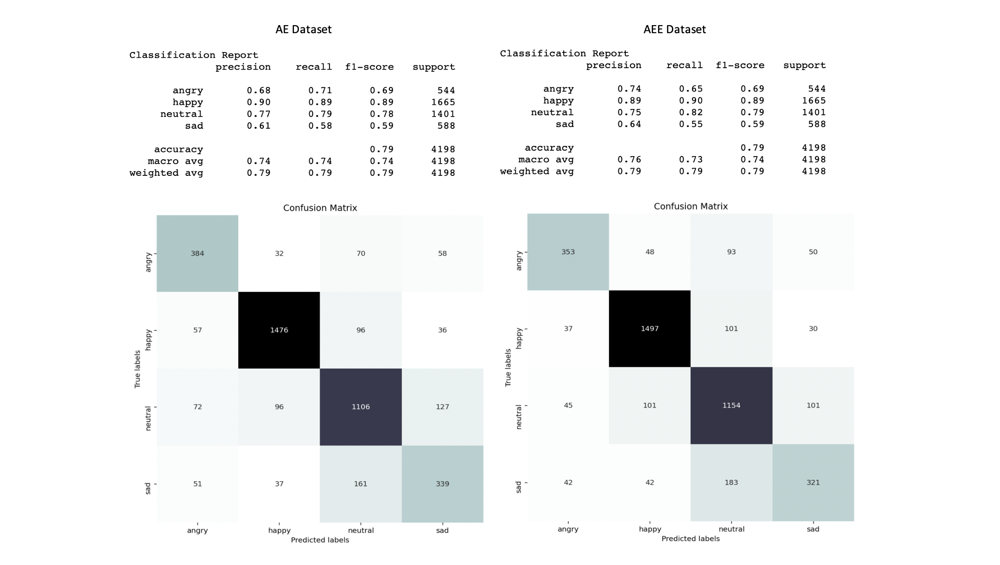

After picking out the dataset, we recombined the train and validation to train the Network and use our test data for the final score. 

----

#### <u>Model Results</u>

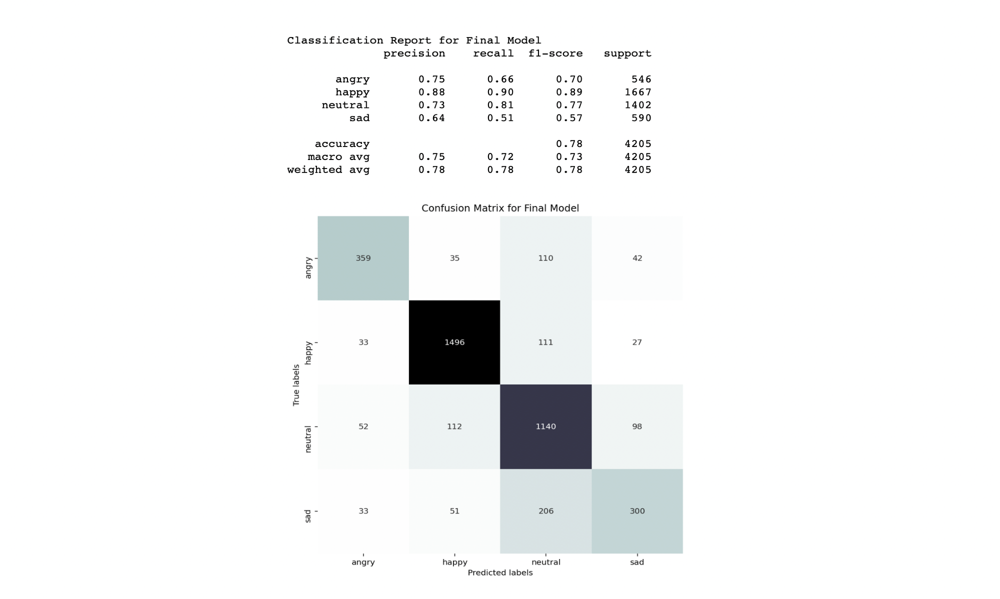

Our final score was a weighted-F1 of 0.78, beating out our baseline by 0.31!

Being fortunate enough to have the resources to experiment on effects on dataset, or network parameters really helped improve the model significantly. We are able to determine that effects do impact the CNN's learning ability. Because CNN is essentially a "blackbox" its true processes cannot be interpreted into correction actions. 

however, to better understand the effects of kernel responses, we may explore the following:
- different kernels captures different information
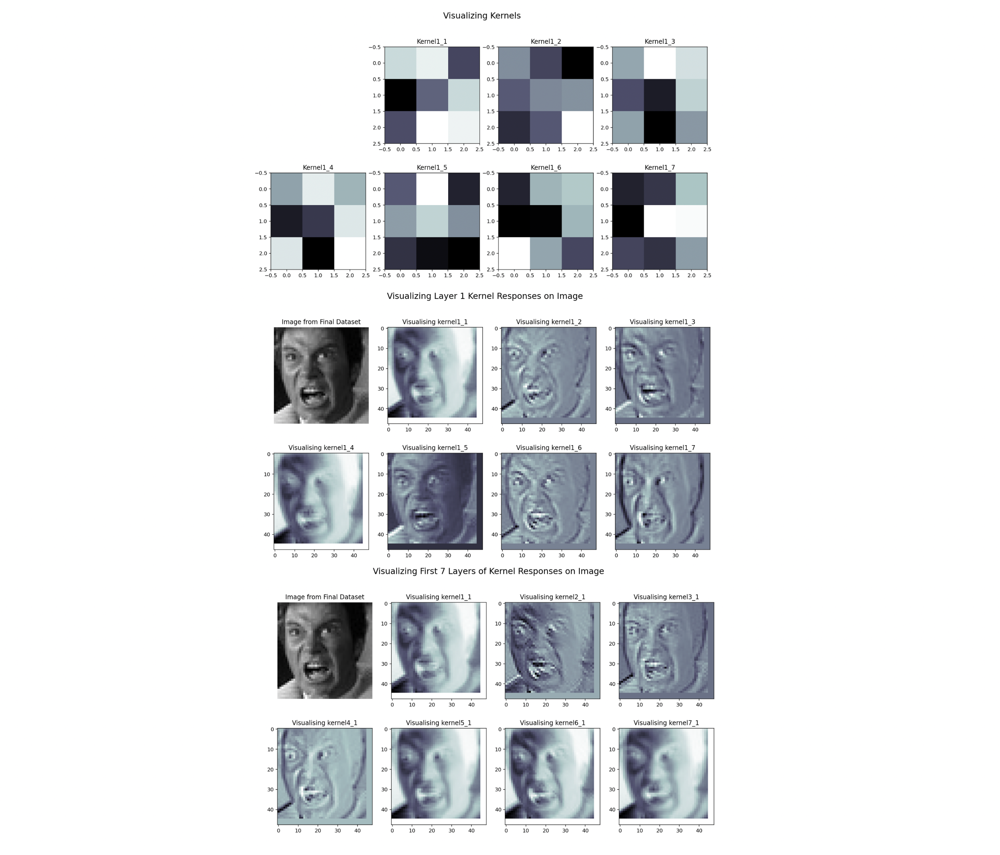



as well as the impact of effects on convolutional layers:
- the different treatments has been captured differently!


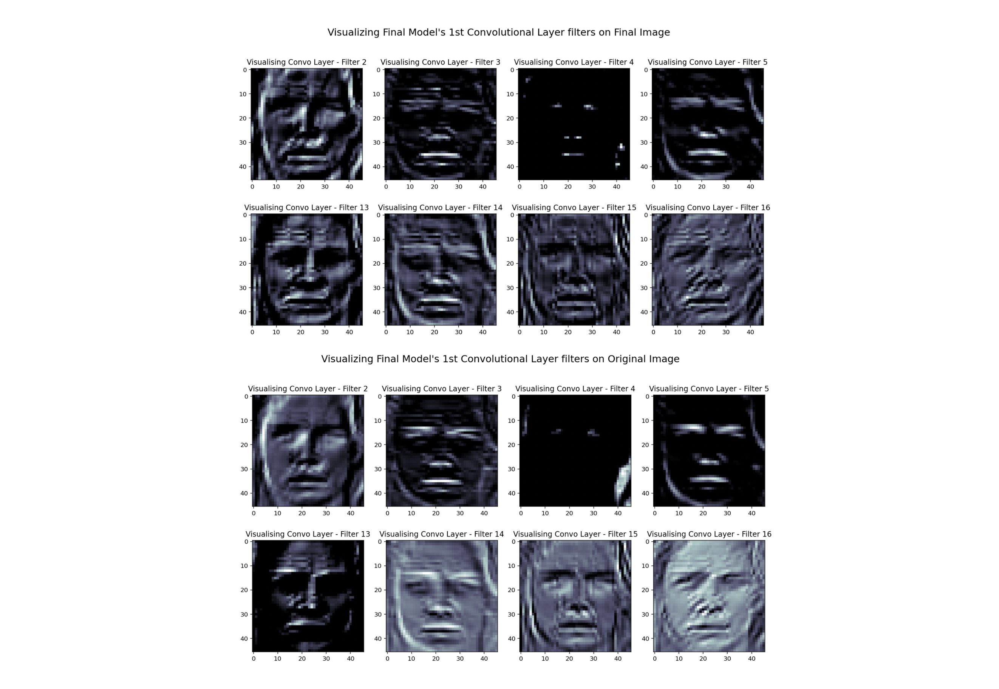

---- 

#### Application of Model:
As the model is now able to successfully detect facial emotions, it can be intergrated with a camera to capture a consumer's emotion and substitute the emotion with a rating:

Example:
Angry - 1 star
Sad - 2 Star
Neutral - 3 star
Happy - 4 star

----

#### Approach to improve model results:
To further improve our model, we may explore more avenues of higher quality images and more images. With more time, we could also explore more emotions to add to the spectrum which will give the rating system a more accurate spectrum. And possible explore the addition of a recommender system to inprove the quality of the reviews.  


#### Model limitations:
As majority of the images came in 48 x 48, with the deadline and lack of other sources of datasets, this resulted in feeding our model a inferior quality of data. Computing resources,memory constraints and time resources also limited the exploration on layers with higher nodes. 


-----


***

## 4.3 Conclusion and Recommendations

While all data points to heavy usage of Apps in the App Store, when browsing through the store, we see only a fraction of user reviews coupled with very skewed ratings. This shows users not leaving their reviews and misrepresentation of ratings due to many reasons.

To improve the quality and quantiy of reviews in the App Store, I prospose the ideal of having the consumer take a real time picture and have a Multi-class Classifier detect emotions and translate it to a quantitative review rating. This new form of reviewing may encourage more users to rate the products in the App Store.  

Using a combined Dataset preprcoessed with Adaptive Exposure and Equalization, the CNN Model was able to achieve a weighted-F1 score of 0.79, beating the baseline score by 0.31. 

The Application of the CNN model would include a real time prediction of emotions by the user, this then will translate to ratings populated by the model tied to each emotional response.

Recommendations to improve the score requires higher quality and quantity of data being fed into the model for further training and generalisation. 

This project also has the future option to add on recommender system to recommend popular words to add to the review. If sucessful, the tool will accurately predict emotions of faces. With sufficient data, it can also be expanded to learn more emotions to broaden the detection spectrum. 

## 4.4 Test My Rater
Run code to start

for mac: to close window, kernel --> 'restart and clear output'

In [ ]:
#load model, start webcam
import cv2
import numpy as np
from time import sleep
from matplotlib import pyplot as plt
from keras.preprocessing.image import ImageDataGenerator, img_to_array
from skimage import exposure

from keras.models import load_model
%matplotlib inline


face_classifier = cv2.CascadeClassifier('haarcascade_frontalface_alt.xml')
classifier =load_model("../models/best_model_aee_final_cp.hdf5")

class_labels = ["Poor", "Excellent", "Good", "Average"]
# class_labels = ["Angry", "Happy", "Neutral", "Sad"]

def face_detector(img):
    # Convert image to grayscale
    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
    faces = face_classifier.detectMultiScale(gray, 1.3, 6)
    if faces is ():
        return (0,0,0,0), np.zeros((48,48), np.uint8), img
    
    for (x,y,w,h) in faces:
        cv2.rectangle(img,(x,y),(x+w,y+h),(79,71,55),5)
        roi_gray = gray[y:y+h, x:x+w]

    try:
        roi_gray = cv2.resize(roi_gray, (48, 48), interpolation = cv2.INTER_AREA)
    except:
        return (x,w,y,h), np.zeros((48,48), np.uint8), img
    return (x,w,y,h), roi_gray, img

cap = cv2.VideoCapture(0)

while True:
    

    ret, frame = cap.read()
    rect, face, image = face_detector(frame)
    if np.sum([face]) != 0.0:
        roi = face.astype("float") / 255.0
        roi = exposure.equalize_adapthist(roi, clip_limit=0.03)
        roi = exposure.equalize_hist(roi)
        roi = img_to_array(roi)
        roi = np.expand_dims(roi, axis=0)

        # make a prediction on the ROI, then lookup the class
        preds = classifier.predict(roi)[0]
        label = class_labels[preds.argmax()]  
        label_position = (rect[0] + int((rect[1]/2)), rect[2] + 25)
        cv2.putText(image, label, label_position , cv2.FONT_ITALIC,1, (102,216,255), 2)
    else:
        cv2.putText(image, "Searching", (20, 60) , cv2.FONT_ITALIC,1, (102,216,255), 2)
        
    cv2.imshow('Ratings Please!', image)
    if cv2.waitKey(1) == 27: #13 is the Esc Key
        break
        
cap.release()
cv2.destroyWindow("window")
cv2.destroyAllWindows()
cv2.waitKey(1)
cv2.waitKey(1)
cv2.waitKey(1)
cv2.waitKey(1)
